In [ ]:
!pip install -U torchvision tensorflow_datasets opencv-python matplotlib imageio -q


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 68.1 MB/s eta 0:00:00


In [ ]:
import torch
import torchvision

print(torch.__version__)
print(torchvision.__version__)


2.7.0+cu126
0.22.0+cu126


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!apt-get install unrar -y
!unrar x "/content/drive/MyDrive/Dataset_DL/UCF101.rar" /content/


Streaming output truncated to the last 5000 lines.
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g06_c05.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g06_c06.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g06_c07.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c01.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c02.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c03.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c04.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c05.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c06.avi      62%  OK 
Extracting  /content/UCF-101/PlayingGuitar/v_PlayingGuitar_g07_c07.avi      62%  OK 
Extractin

In [ ]:
import os


dataset_path = "/content/UCF-101"


class_list = sorted(os.listdir(dataset_path))
print(f"Total classes found: {len(class_list)}")

video_paths = []

for cls in class_list:
    cls_path = os.path.join(dataset_path, cls)
    videos = [f for f in os.listdir(cls_path) if f.lower().endswith(".avi")]
    full_paths = [os.path.join(cls_path, v) for v in videos]
    video_paths.extend(full_paths)

print(f"Total videos collected: {len(video_paths)}")
print("Sample videos:", video_paths[:5])


Total classes found: 101
Total videos collected: 13320
Sample videos: ['/content/UCF-101/ApplyEyeMakeup/v_ApplyEyeMakeup_g18_c02.avi', '/content/UCF-101/ApplyEyeMakeup/v_ApplyEyeMakeup_g02_c04.avi', '/content/UCF-101/ApplyEyeMakeup/v_ApplyEyeMakeup_g16_c03.avi', '/content/UCF-101/ApplyEyeMakeup/v_ApplyEyeMakeup_g19_c03.avi', '/content/UCF-101/ApplyEyeMakeup/v_ApplyEyeMakeup_g06_c05.avi']


In [ ]:
import torch
import torchvision.transforms as T
from torchvision.models.optical_flow import raft_small, Raft_Small_Weights
import cv2
from tqdm import tqdm
import numpy as np


device = "cuda" if torch.cuda.is_available() else "cpu"
raft = raft_small(weights=Raft_Small_Weights.DEFAULT).to(device).eval()
raft_transform = Raft_Small_Weights.DEFAULT.transforms()

print("Using device:", device)


max_frames = 32


all_motion_sequences = []


for path in tqdm(video_paths, desc="Processing videos"):
    try:
        cap = cv2.VideoCapture(path)
        frames = []
        while True:
            ret, frame = cap.read()
            if not ret or len(frames) >= max_frames:
                break
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            frame_resized = cv2.resize(frame_rgb, (256, 256))
            frames.append(frame_resized)
        cap.release()

        if len(frames) < 2:
            continue

        frame_tensors = torch.stack([T.ToTensor()(f) for f in frames])

        flow_vectors = []

        for i in range(len(frame_tensors) - 1):
            img1, img2 = raft_transform(frame_tensors[i], frame_tensors[i + 1])
            img1 = img1.unsqueeze(0).to(device)
            img2 = img2.unsqueeze(0).to(device)

            with torch.no_grad():
                flow = raft(img1, img2)[-1].squeeze(0).cpu()

            avg_flow = torch.mean(flow.view(2, -1), dim=1).numpy()
            flow_vectors.append(avg_flow)

        if len(flow_vectors) > 0:
            all_motion_sequences.append(np.array(flow_vectors))

    except Exception as e:
        print(f"Error processing {path}: {e}")
        continue

print(f"Total motion sequences extracted: {len(all_motion_sequences)}")


Downloading: "https://download.pytorch.org/models/raft_small_C_T_V2-01064c6d.pth" to /root/.cache/torch/hub/checkpoints/raft_small_C_T_V2-01064c6d.pth


100%|██████████| 3.82M/3.82M [00:00<00:00, 49.8MB/s]


Using device: cuda


Processing videos: 100%|██████████| 13320/13320 [3:57:57<00:00,  1.07s/it]

Total motion sequences extracted: 13320


In [ ]:
import torch.nn as nn
from torch.nn.utils.rnn import pad_sequence

motion_tensors = [torch.tensor(seq, dtype=torch.float32) for seq in all_motion_sequences]

target_tensors = []
for seq in motion_tensors:
    smoothed = []
    for i in range(len(seq)):
        start = max(0, i-1)
        end = min(len(seq), i+2)
        avg = seq[start:end].mean(dim=0)
        smoothed.append(avg)
    target_tensors.append(torch.stack(smoothed))

motion_padded = pad_sequence(motion_tensors, batch_first=True)
target_padded = pad_sequence(target_tensors, batch_first=True)

lengths = [len(seq) for seq in motion_tensors]
mask = torch.arange(motion_padded.shape[1])[None, :] < torch.tensor(lengths)[:, None]

print(f"Padded motion shape: {motion_padded.shape}")
print(f"Padded target shape: {target_padded.shape}")


Padded motion shape: torch.Size([13320, 31, 2])
Padded target shape: torch.Size([13320, 31, 2])


In [ ]:
class MotionBiLSTM(nn.Module):
    def __init__(self, input_dim=2, hidden_dim=32):
        super(MotionBiLSTM, self).__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_dim * 2, input_dim)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out)
        return out

model = MotionBiLSTM().to(device)

motion_padded = motion_padded.to(device)
target_padded = target_padded.to(device)
mask = mask.to(device)

criterion = nn.MSELoss(reduction='none')
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

num_epochs = 200
for epoch in range(1, num_epochs + 1):
    model.train()
    optimizer.zero_grad()

    output = model(motion_padded)
    loss_per_timestep = criterion(output, target_padded).sum(dim=2)
    masked_loss = (loss_per_timestep * mask).sum() / mask.sum()
    masked_loss.backward()
    optimizer.step()

    if epoch % 10 == 0 or epoch == 1:
        print(f"Epoch {epoch}, Loss: {masked_loss.item():.6f}")

print("Training complete.")


Epoch 1, Loss: 3.964496
Epoch 10, Loss: 3.689553
Epoch 20, Loss: 3.380594
Epoch 30, Loss: 3.050351
Epoch 40, Loss: 2.689186
Epoch 50, Loss: 2.333072
Epoch 60, Loss: 2.054695
Epoch 70, Loss: 1.816423
Epoch 80, Loss: 1.620038
Epoch 90, Loss: 1.457951
Epoch 100, Loss: 1.319779
Epoch 110, Loss: 1.205581
Epoch 120, Loss: 1.112381
Epoch 130, Loss: 1.036408
Epoch 140, Loss: 0.973301
Epoch 150, Loss: 0.919611
Epoch 160, Loss: 0.873394
Epoch 170, Loss: 0.833250
Epoch 180, Loss: 0.797941
Epoch 190, Loss: 0.766435
Epoch 200, Loss: 0.737938
Training complete.


In [ ]:
torch.save(model.state_dict(), "final_bilstm_motion_smoother.pth")
print("Model checkpoint saved as final_bilstm_motion_smoother.pth")


Model checkpoint saved as final_bilstm_motion_smoother.pth


In [ ]:
loss_list = []

for epoch in range(1, 201):
    model.train()
    optimizer.zero_grad()
    output = model(motion_padded)
    loss_per_timestep = criterion(output, target_padded).sum(dim=2)
    masked_loss = (loss_per_timestep * mask).sum() / mask.sum()
    masked_loss.backward()
    optimizer.step()

    loss_list.append(masked_loss.item())

    if epoch % 10 == 0:
        print(f"Epoch {epoch}, Loss: {masked_loss.item():.6f}")


Epoch 10, Loss: 0.711881
Epoch 20, Loss: 0.687830
Epoch 30, Loss: 0.665484
Epoch 40, Loss: 0.644621
Epoch 50, Loss: 0.625051
Epoch 60, Loss: 0.606618
Epoch 70, Loss: 0.589162
Epoch 80, Loss: 0.572542
Epoch 90, Loss: 0.556643
Epoch 100, Loss: 0.541356
Epoch 110, Loss: 0.526590
Epoch 120, Loss: 0.512318
Epoch 130, Loss: 0.498523
Epoch 140, Loss: 0.485192
Epoch 150, Loss: 0.472366
Epoch 160, Loss: 0.459994
Epoch 170, Loss: 0.448044
Epoch 180, Loss: 0.436527
Epoch 190, Loss: 0.425413
Epoch 200, Loss: 0.414727


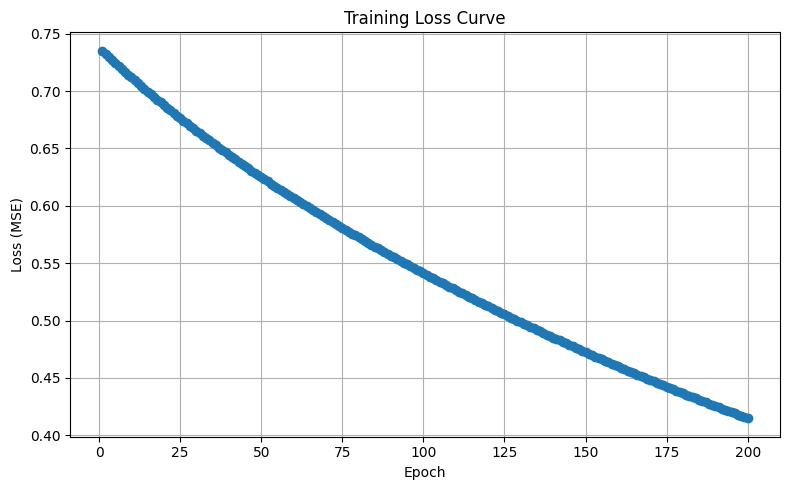

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
plt.plot(range(1, len(loss_list)+1), loss_list, marker='o')
plt.title('Training Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.grid(True)
plt.tight_layout()
plt.show()


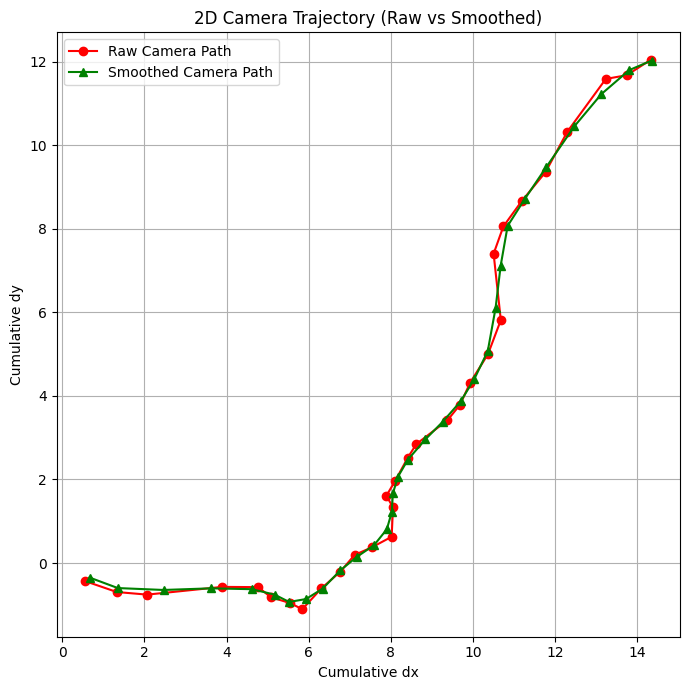

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

raw_motion = motion_tensors[0].cpu().numpy()
target_motion = target_tensors[0].cpu().numpy()

raw_path = np.cumsum(raw_motion, axis=0)
smooth_path = np.cumsum(target_motion, axis=0)

plt.figure(figsize=(7,7))
plt.plot(raw_path[:,0], raw_path[:,1], 'r-o', label='Raw Camera Path')
plt.plot(smooth_path[:,0], smooth_path[:,1], 'g-^', label='Smoothed Camera Path')
plt.title('2D Camera Trajectory (Raw vs Smoothed)')
plt.xlabel('Cumulative dx')
plt.ylabel('Cumulative dy')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


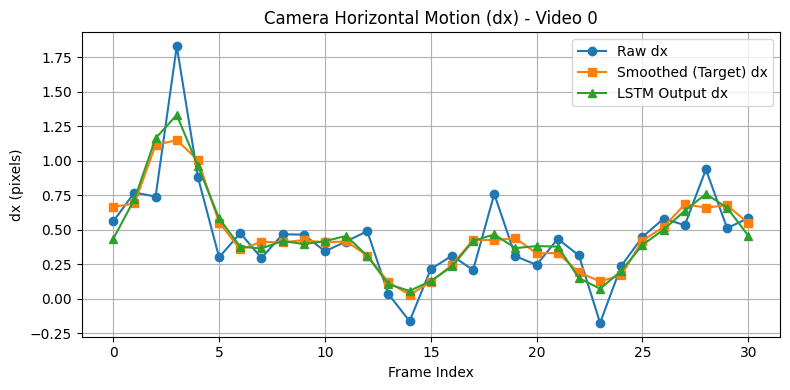

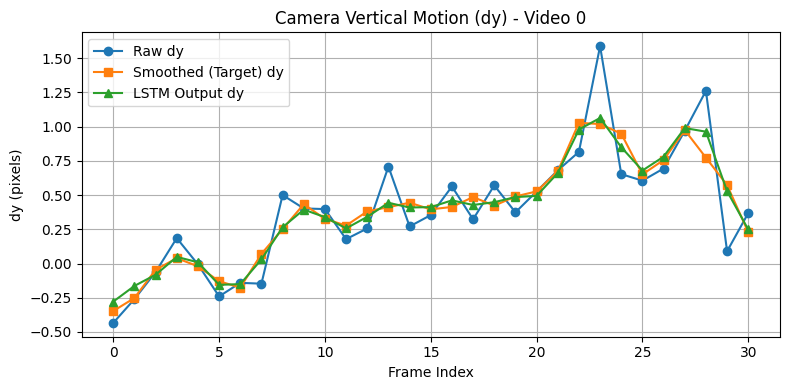

In [ ]:
import matplotlib.pyplot as plt

sample_idx = 0
raw_motion = motion_tensors[sample_idx].unsqueeze(0).to(device)
target_motion = target_tensors[sample_idx].cpu().numpy()
seq_length = raw_motion.shape[1]
model.eval()
with torch.no_grad():
    pred_motion = model(raw_motion).squeeze(0).cpu().numpy()

raw_dx = raw_motion.squeeze(0).cpu().numpy()[:, 0]
target_dx = target_motion[:, 0]
pred_dx = pred_motion[:, 0]

raw_dy = raw_motion.squeeze(0).cpu().numpy()[:, 1]
target_dy = target_motion[:, 1]
pred_dy = pred_motion[:, 1]

plt.figure(figsize=(8, 4))
plt.plot(raw_dx, 'o-', label='Raw dx')
plt.plot(target_dx, 's-', label='Smoothed (Target) dx')
plt.plot(pred_dx, '^-', label='LSTM Output dx')
plt.title(f"Camera Horizontal Motion (dx) - Video {sample_idx}")
plt.xlabel("Frame Index")
plt.ylabel("dx (pixels)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 4))
plt.plot(raw_dy, 'o-', label='Raw dy')
plt.plot(target_dy, 's-', label='Smoothed (Target) dy')
plt.plot(pred_dy, '^-', label='LSTM Output dy')
plt.title(f"Camera Vertical Motion (dy) - Video {sample_idx}")
plt.xlabel("Frame Index")
plt.ylabel("dy (pixels)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np

raw_motion = motion_tensors[0].cpu().numpy()
target_motion = target_tensors[0].cpu().numpy()

raw_var = np.var(raw_motion)
smooth_var = np.var(target_motion)

smoothing_score = raw_var / smooth_var

print(f"Raw motion variance: {raw_var:.6f}")
print(f"Smoothed motion variance: {smooth_var:.6f}")
print(f"Smoothing Improvement Ratio: {smoothing_score:.2f}")


Raw motion variance: 0.158846
Smoothed motion variance: 0.104926
Smoothing Improvement Ratio: 1.51


In [ ]:
import os
import cv2
import numpy as np
import imageio
from PIL import Image, ImageDraw, ImageFont
from IPython.display import HTML
import base64
from torchvision.transforms import ToTensor
import torch
from torchvision.models.optical_flow import raft_small, Raft_Small_Weights

def add_labels(frame1, frame2, label1="Before", label2="After"):
    """Adds labels on top of two PIL images and stacks them horizontally."""
    label_height = 30
    width1, height = frame1.size
    width2, _ = frame2.size

    new_frame1 = Image.new("RGB", (width1, height + label_height), (255, 255, 255))
    new_frame2 = Image.new("RGB", (width2, height + label_height), (255, 255, 255))

    new_frame1.paste(frame1, (0, label_height))
    new_frame2.paste(frame2, (0, label_height))

    draw1 = ImageDraw.Draw(new_frame1)
    draw2 = ImageDraw.Draw(new_frame2)
    draw1.text((width1 // 2 - 20, 5), label1, fill="black")
    draw2.text((width2 // 2 - 20, 5), label2, fill="black")

    return Image.fromarray(np.hstack((np.array(new_frame1), np.array(new_frame2))))

def generate_motion_gif(video_path, model, max_frames=32, scale=10, fps=10):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while True:
        ret, frame = cap.read()
        if not ret or len(frames) >= max_frames:
            break
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame_resized = cv2.resize(frame_rgb, (256, 256))
        frames.append(frame_resized)
    cap.release()

    if len(frames) < 2:
        print("Not enough frames.")
        return

    frame_tensors = torch.stack([ToTensor()(f) for f in frames]).to(device)

    raft = raft_small(weights=Raft_Small_Weights.DEFAULT).to(device).eval()
    transform = Raft_Small_Weights.DEFAULT.transforms()

    flow_vectors = []
    for i in range(len(frame_tensors) - 1):
        img1, img2 = transform(frame_tensors[i], frame_tensors[i + 1])
        img1 = img1.unsqueeze(0).to(device)
        img2 = img2.unsqueeze(0).to(device)
        with torch.no_grad():
            flow = raft(img1, img2)[-1].squeeze(0).cpu()
        avg_flow = torch.mean(flow.view(2, -1), dim=1).numpy()
        flow_vectors.append(avg_flow)

    flow_vectors = np.array(flow_vectors)

    input_tensor = torch.tensor(flow_vectors, dtype=torch.float32).unsqueeze(0).to(device)
    with torch.no_grad():
        predicted_motion = model(input_tensor).squeeze(0).cpu().numpy()

    raw_shift = (np.cumsum(flow_vectors, axis=0) * scale).astype(int)
    pred_shift = (np.cumsum(predicted_motion, axis=0) * scale).astype(int)

    def crop(frame, shift):
        x0, y0 = 28 + shift[0], 28 + shift[1]
        x0 = np.clip(x0, 0, 56)
        y0 = np.clip(y0, 0, 56)
        return frame.crop((x0, y0, x0 + 200, y0 + 200))

    pil_frames = [Image.fromarray(f) for f in frames]
    comparison_frames = [
        add_labels(crop(pil_frames[i], raw_shift[i]), crop(pil_frames[i], pred_shift[i]))
        for i in range(len(raw_shift))
    ]

    gif_path = "labeled_comparison.gif"
    imageio.mimsave(gif_path, comparison_frames, fps=fps,loop=0)

    with open(gif_path, "rb") as f:
        gif_bytes = f.read()
    encoded_gif = base64.b64encode(gif_bytes).decode("utf-8")

    return HTML(f"<img src='data:image/gif;base64,{encoded_gif}' loop autoplay>")




Generating for: /content/UCF-101/TennisSwing/v_TennisSwing_g20_c02.avi



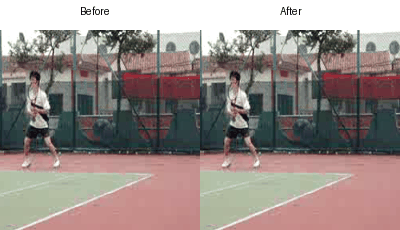

Generating for: /content/UCF-101/VolleyballSpiking/v_VolleyballSpiking_g03_c01.avi



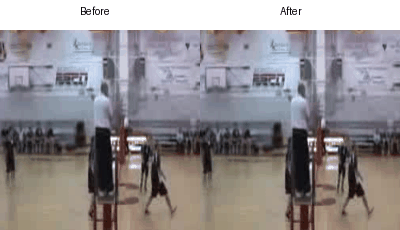

Generating for: /content/UCF-101/GolfSwing/v_GolfSwing_g19_c04.avi



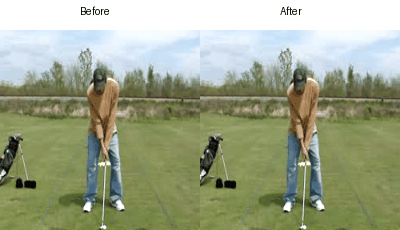

Generating for: /content/UCF-101/MilitaryParade/v_MilitaryParade_g19_c03.avi



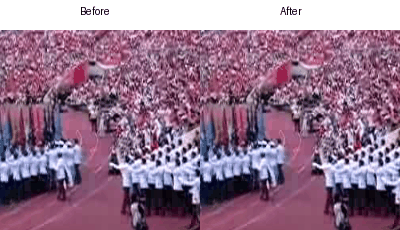

Generating for: /content/UCF-101/HeadMassage/v_HeadMassage_g11_c05.avi



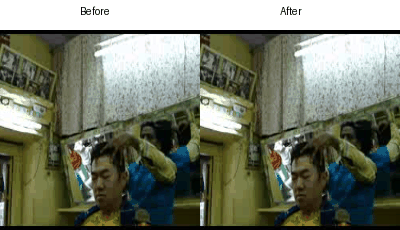

In [ ]:
import random

sample_videos = random.sample(video_paths, 5)

for vid_path in sample_videos:
    print(f"Generating for: {vid_path}")
    display(generate_motion_gif(vid_path, model))


In [ ]:
import cv2
import numpy as np
import torch
from PIL import Image, ImageDraw, ImageFont
from torchvision.transforms import ToTensor
from torchvision.models.optical_flow import raft_small, Raft_Small_Weights

def draw_labels(frame1, frame2, label1="Before", label2="After"):
    label_height = 30
    w, h = frame1.size

    canvas1 = Image.new("RGB", (w, h + label_height), (255, 255, 255))
    canvas2 = Image.new("RGB", (w, h + label_height), (255, 255, 255))

    canvas1.paste(frame1, (0, label_height))
    canvas2.paste(frame2, (0, label_height))

    draw1 = ImageDraw.Draw(canvas1)
    draw2 = ImageDraw.Draw(canvas2)

    draw1.text((w // 2 - 30, 5), label1, fill="black")
    draw2.text((w // 2 - 30, 5), label2, fill="black")

    return np.hstack((np.array(canvas1), np.array(canvas2)))

def save_comparison_video(video_path, model, output_path="comparison_video.mp4", max_frames=32, scale=10, fps=10):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while True:
        ret, frame = cap.read()
        if not ret or len(frames) >= max_frames:
            break
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame_resized = cv2.resize(frame_rgb, (256, 256))
        frames.append(frame_resized)
    cap.release()

    if len(frames) < 2:
        print("Not enough frames.")
        return

    pil_frames = [Image.fromarray(f) for f in frames]
    frame_tensors = torch.stack([ToTensor()(f) for f in frames]).to(device)

    raft = raft_small(weights=Raft_Small_Weights.DEFAULT).to(device).eval()
    transform = Raft_Small_Weights.DEFAULT.transforms()

    flow_vectors = []
    for i in range(len(frame_tensors) - 1):
        img1, img2 = transform(frame_tensors[i], frame_tensors[i + 1])
        img1 = img1.unsqueeze(0).to(device)
        img2 = img2.unsqueeze(0).to(device)
        with torch.no_grad():
            flow = raft(img1, img2)[-1].squeeze(0).cpu()
        avg_flow = torch.mean(flow.view(2, -1), dim=1).numpy()
        flow_vectors.append(avg_flow)
    flow_vectors = np.array(flow_vectors)

    motion_input = torch.tensor(flow_vectors, dtype=torch.float32).unsqueeze(0).to(device)
    with torch.no_grad():
        pred_motion = model(motion_input).squeeze(0).cpu().numpy()

    raw_shift = (np.cumsum(flow_vectors, axis=0) * scale).astype(int)
    pred_shift = (np.cumsum(pred_motion, axis=0) * scale).astype(int)

    def crop_shift(frame, shift):
        x0, y0 = 28 + shift[0], 28 + shift[1]
        x0 = np.clip(x0, 0, 56)
        y0 = np.clip(y0, 0, 56)
        return frame.crop((x0, y0, x0 + 200, y0 + 200))

    comparison_frames = [
        draw_labels(
            crop_shift(pil_frames[i], raw_shift[i]),
            crop_shift(pil_frames[i], pred_shift[i])
        )
        for i in range(len(raw_shift))
    ]

    height, width, _ = comparison_frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    for frame in comparison_frames:
        out.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
    out.release()

    print(f"Saved comparison video to {output_path}")


save_comparison_video(video_paths[0], model, output_path="comparison_ucf101.mp4")


Saved comparison video to comparison_ucf101.mp4


In [ ]:
import os
import cv2
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import torch
import imageio
from torchvision.transforms import ToTensor
from torchvision.models.optical_flow import raft_small, Raft_Small_Weights
import randomå

def add_labels(before_img, after_img, label1="Before", label2="After"):
    w, h = before_img.size
    label_height = 30
    font = ImageFont.load_default()

    labeled_before = Image.new("RGB", (w, h + label_height), (255, 255, 255))
    labeled_after = Image.new("RGB", (w, h + label_height), (255, 255, 255))

    labeled_before.paste(before_img, (0, label_height))
    labeled_after.paste(after_img, (0, label_height))

    draw1 = ImageDraw.Draw(labeled_before)
    draw2 = ImageDraw.Draw(labeled_after)

    draw1.text((w // 2 - 30, 5), label1, fill="black", font=font)
    draw2.text((w // 2 - 30, 5), label2, fill="black", font=font)

    combined = np.hstack((np.array(labeled_before), np.array(labeled_after)))
    return combined

def save_comparison_video(video_path, model, output_path="comparison_video.mp4", max_frames=32, scale=10, fps=10):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while True:
        ret, frame = cap.read()
        if not ret or len(frames) >= max_frames:
            break
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame_resized = cv2.resize(frame_rgb, (256, 256))
        frames.append(frame_resized)
    cap.release()

    if len(frames) < 2:
        print(f"Not enough frames for {video_path}")
        return

    pil_frames = [Image.fromarray(f) for f in frames]
    frame_tensors = torch.stack([ToTensor()(f) for f in frames]).to(device)

    raft = raft_small(weights=Raft_Small_Weights.DEFAULT).to(device).eval()
    transform = Raft_Small_Weights.DEFAULT.transforms()

    flow_vectors = []
    for i in range(len(frame_tensors) - 1):
        img1, img2 = transform(frame_tensors[i], frame_tensors[i + 1])
        img1 = img1.unsqueeze(0)
        img2 = img2.unsqueeze(0)
        with torch.no_grad():
            flow = raft(img1.to(device), img2.to(device))[-1].squeeze(0).cpu()
        avg_flow = torch.mean(flow.view(2, -1), dim=1).numpy()
        flow_vectors.append(avg_flow)
    flow_vectors = np.array(flow_vectors)

    motion_input = torch.tensor(flow_vectors, dtype=torch.float32).unsqueeze(0).to(device)
    with torch.no_grad():
        pred_motion = model(motion_input).squeeze(0).cpu().numpy()

    raw_shift = (np.cumsum(flow_vectors, axis=0) * scale).astype(int)
    pred_shift = (np.cumsum(pred_motion, axis=0) * scale).astype(int)

    def crop_shift(frame, shift):
        x0, y0 = 28 + shift[0], 28 + shift[1]
        x0 = np.clip(x0, 0, 56)
        y0 = np.clip(y0, 0, 56)
        return frame.crop((x0, y0, x0 + 200, y0 + 200))

    raw_cropped = [crop_shift(pil_frames[i], raw_shift[i]) for i in range(len(raw_shift))]
    pred_cropped = [crop_shift(pil_frames[i], pred_shift[i]) for i in range(len(pred_shift))]

    comparison_frames = [add_labels(raw_cropped[i], pred_cropped[i]) for i in range(len(raw_cropped))]

    height, width, _ = comparison_frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    for frame in comparison_frames:
        out.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
    out.release()
    print(f"Saved comparison video: {output_path}")

sample_videos = random.sample(video_paths, 5)
for idx, vid_path in enumerate(sample_videos):
    save_comparison_video(
        vid_path,
        model,
        output_path=f"comparison_ucf101_sample_{idx}.mp4"
    )


Saved comparison video: comparison_ucf101_sample_0.mp4
Saved comparison video: comparison_ucf101_sample_1.mp4
Saved comparison video: comparison_ucf101_sample_2.mp4
Saved comparison video: comparison_ucf101_sample_3.mp4
Saved comparison video: comparison_ucf101_sample_4.mp4


In [ ]:
torch.save(model.state_dict(), "final_bilstm_motion_smoother.pth")
print(" Final Bi-LSTM model weights saved as final_bilstm_motion_smoother.pth")


 Final Bi-LSTM model weights saved as final_bilstm_motion_smoother.pth


In [ ]:
!wget https://data.vision.ee.ethz.ch/csergi/share/davis/DAVIS-test-480p.zip
!unzip -q DAVIS-test-480p.zip


--2025-05-01 09:05:03--  https://data.vision.ee.ethz.ch/csergi/share/davis/DAVIS-test-480p.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2025-05-01 09:05:04 ERROR 404: Not Found.

unzip:  cannot find or open DAVIS-test-480p.zip, DAVIS-test-480p.zip.zip or DAVIS-test-480p.zip.ZIP.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!apt-get install unzip -y

!unzip "/content/drive/MyDrive/Dataset_DL/DAVIS-2017-trainval-480p.zip" -d /content/


Streaming output truncated to the last 5000 lines.
  inflating: /content/DAVIS/JPEGImages/480p/color-run/00078.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/color-run/00079.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/color-run/00080.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/color-run/00081.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/color-run/00082.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/color-run/00083.jpg  
   creating: /content/DAVIS/JPEGImages/480p/cows/
  inflating: /content/DAVIS/JPEGImages/480p/cows/00000.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00001.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00002.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00003.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00004.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00005.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00006.jpg  
  inflating: /content/DAVIS/JPEGImages/480p/cows/00007.jpg  
  inflating: /c

In [ ]:
import os

davis_path = "/content/DAVIS/JPEGImages/480p"

video_folders = sorted(os.listdir(davis_path))
print(f"Total videos found in DAVIS: {len(video_folders)}")

video_frames = {}

for vid_name in video_folders:
    vid_folder = os.path.join(davis_path, vid_name)
    frames = sorted([os.path.join(vid_folder, f) for f in os.listdir(vid_folder) if f.endswith('.jpg')])
    if len(frames) >= 2:
        video_frames[vid_name] = frames

print(f"Total videos with >=2 frames: {len(video_frames)}")
for vid, frames in list(video_frames.items())[:3]:
    print(f"\nVideo: {vid}")
    print(f"Frames sample: {frames[:3]}")


Total videos found in DAVIS: 90
Total videos with >=2 frames: 90

Video: bear
Frames sample: ['/content/DAVIS/JPEGImages/480p/bear/00000.jpg', '/content/DAVIS/JPEGImages/480p/bear/00001.jpg', '/content/DAVIS/JPEGImages/480p/bear/00002.jpg']

Video: bike-packing
Frames sample: ['/content/DAVIS/JPEGImages/480p/bike-packing/00000.jpg', '/content/DAVIS/JPEGImages/480p/bike-packing/00001.jpg', '/content/DAVIS/JPEGImages/480p/bike-packing/00002.jpg']

Video: blackswan
Frames sample: ['/content/DAVIS/JPEGImages/480p/blackswan/00000.jpg', '/content/DAVIS/JPEGImages/480p/blackswan/00001.jpg', '/content/DAVIS/JPEGImages/480p/blackswan/00002.jpg']


In [ ]:
import torch
from torchvision.transforms import ToTensor
from torchvision.models.optical_flow import raft_small, Raft_Small_Weights
import cv2
from tqdm import tqdm

device = "cuda" if torch.cuda.is_available() else "cpu"
raft_model = raft_small(weights=Raft_Small_Weights.DEFAULT).to(device).eval()
raft_transform = Raft_Small_Weights.DEFAULT.transforms()

davis_motion_sequences = {}

for vid_name, frames in tqdm(video_frames.items(), desc="Processing DAVIS videos"):
    frame_tensors = []
    for frame_path in frames:
        img = cv2.imread(frame_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_resized = cv2.resize(img_rgb, (256, 256))
        frame_tensor = ToTensor()(img_resized)
        frame_tensors.append(frame_tensor)

    frame_tensors = torch.stack(frame_tensors)

    flow_vectors = []
    for i in range(len(frame_tensors) - 1):
        img1, img2 = raft_transform(frame_tensors[i], frame_tensors[i + 1])
        img1 = img1.unsqueeze(0).to(device)
        img2 = img2.unsqueeze(0).to(device)

        with torch.no_grad():
            flow = raft_model(img1, img2)[-1].squeeze(0).cpu()

        avg_flow = torch.mean(flow.view(2, -1), dim=1).numpy()
        flow_vectors.append(avg_flow)

    davis_motion_sequences[vid_name] = np.array(flow_vectors)

print(f"\n Extracted motion sequences for {len(davis_motion_sequences)} videos")


Processing DAVIS videos: 100%|██████████| 90/90 [03:54<00:00,  2.61s/it]


 Extracted motion sequences for 90 videos


In [ ]:
import torch
import torch.nn as nn

class MotionBiLSTM(nn.Module):
    def __init__(self, input_dim=2, hidden_dim=32):
        super().__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_dim * 2, input_dim)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out)
        return out

device = "cuda" if torch.cuda.is_available() else "cpu"
model = MotionBiLSTM().to(device)

model.load_state_dict(torch.load("/content/final_bilstm_motion_smoother.pth"))
model.eval()

print("Bi-LSTM model loaded.")

davis_smoothed_motions = {}

for vid_name, motion_seq in davis_motion_sequences.items():
    motion_tensor = torch.tensor(motion_seq, dtype=torch.float32).unsqueeze(0).to(device)
    with torch.no_grad():
        smoothed_motion = model(motion_tensor).squeeze(0).cpu().numpy()
    davis_smoothed_motions[vid_name] = smoothed_motion

print(f"\n Smoothed motions predicted for {len(davis_smoothed_motions)} videos.")


Bi-LSTM model loaded.

 Smoothed motions predicted for 90 videos.


In [ ]:
import os
import cv2
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import torch

def add_labels(before_img, after_img, label1="Before", label2="After"):
    w, h = before_img.size
    label_height = 30
    font = ImageFont.load_default()

    labeled_before = Image.new("RGB", (w, h + label_height), (255, 255, 255))
    labeled_after = Image.new("RGB", (w, h + label_height), (255, 255, 255))

    labeled_before.paste(before_img, (0, label_height))
    labeled_after.paste(after_img, (0, label_height))

    draw1 = ImageDraw.Draw(labeled_before)
    draw2 = ImageDraw.Draw(labeled_after)

    draw1.text((w // 2 - 30, 5), label1, fill="black", font=font)
    draw2.text((w // 2 - 30, 5), label2, fill="black", font=font)

    combined = np.hstack((np.array(labeled_before), np.array(labeled_after)))
    return combined

def create_comparison_video(vid_name, output_path="comparison_davis.mp4", scale=10, fps=10, max_frames=30):
    frames = video_frames[vid_name]
    raw_motion = davis_motion_sequences[vid_name]
    smooth_motion = davis_smoothed_motions[vid_name]

    motion_len = len(raw_motion)
    available_frames = min(motion_len, len(frames)-1, max_frames)

    pil_frames = []
    for frame_path in frames[:available_frames + 1]:
        img = cv2.imread(frame_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_resized = cv2.resize(img_rgb, (256, 256))
        pil_frames.append(Image.fromarray(img_resized))

    if len(pil_frames) <= 1:
        print(f" Not enough frames for {vid_name}")
        return

    def crop_shift(frame, shift):
        x0, y0 = 28 + shift[0], 28 + shift[1]
        x0 = np.clip(x0, 0, 56)
        y0 = np.clip(y0, 0, 56)
        return frame.crop((x0, y0, x0 + 200, y0 + 200))

    raw_shift = (np.cumsum(raw_motion, axis=0) * scale).astype(int)
    smooth_shift = (np.cumsum(smooth_motion, axis=0) * scale).astype(int)

    raw_cropped = [crop_shift(pil_frames[i], raw_shift[i]) for i in range(available_frames)]
    smooth_cropped = [crop_shift(pil_frames[i], smooth_shift[i]) for i in range(available_frames)]

    comparison_frames = [
        add_labels(raw_cropped[i], smooth_cropped[i], "Before", "After")
        for i in range(available_frames)
    ]

    height, width, _ = comparison_frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    for frame in comparison_frames:
        out.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
    out.release()

    print(f" Saved comparison video: {output_path}")


In [ ]:
import random

sample_videos = random.sample(list(video_frames.keys()), 5)

for idx, vid_name in enumerate(sample_videos):
    create_comparison_video(
        vid_name,
        output_path=f"davis_comparison_{idx}.mp4"
    )


 Saved comparison video: davis_comparison_0.mp4
 Saved comparison video: davis_comparison_1.mp4
 Saved comparison video: davis_comparison_2.mp4
 Saved comparison video: davis_comparison_3.mp4
 Saved comparison video: davis_comparison_4.mp4


In [ ]:
import imageio
import numpy as np
import cv2
from PIL import Image, ImageDraw, ImageFont
from IPython.display import HTML, display
import base64

def add_labels_to_gif_frame(before_img, after_img, label1="Before", label2="After"):
    w, h = before_img.size
    label_height = 30
    font = ImageFont.load_default()

    labeled_before = Image.new("RGB", (w, h + label_height), (255, 255, 255))
    labeled_after = Image.new("RGB", (w, h + label_height), (255, 255, 255))

    labeled_before.paste(before_img, (0, label_height))
    labeled_after.paste(after_img, (0, label_height))

    draw1 = ImageDraw.Draw(labeled_before)
    draw2 = ImageDraw.Draw(labeled_after)

    draw1.text((w // 2 - 30, 5), label1, fill="black", font=font)
    draw2.text((w // 2 - 30, 5), label2, fill="black", font=font)

    combined = np.hstack((np.array(labeled_before), np.array(labeled_after)))
    return combined

def create_comparison_gif(vid_name, output_path="comparison.gif", scale=10, fps=10, max_frames=30):
    frames = video_frames[vid_name]
    raw_motion = davis_motion_sequences[vid_name]
    smooth_motion = davis_smoothed_motions[vid_name]

    motion_len = len(raw_motion)
    available_frames = min(motion_len, len(frames)-1, max_frames)

    pil_frames = []
    for frame_path in frames[:available_frames + 1]:
        img = cv2.imread(frame_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_resized = cv2.resize(img_rgb, (256, 256))
        pil_frames.append(Image.fromarray(img_resized))

    if len(pil_frames) <= 1:
        print(f" Not enough frames for {vid_name}")
        return

    def crop_shift(frame, shift):
        x0, y0 = 28 + shift[0], 28 + shift[1]
        x0 = np.clip(x0, 0, 56)
        y0 = np.clip(y0, 0, 56)
        return frame.crop((x0, y0, x0 + 200, y0 + 200))

    raw_shift = (np.cumsum(raw_motion, axis=0) * scale).astype(int)
    smooth_shift = (np.cumsum(smooth_motion, axis=0) * scale).astype(int)

    raw_cropped = [crop_shift(pil_frames[i], raw_shift[i]) for i in range(available_frames)]
    smooth_cropped = [crop_shift(pil_frames[i], smooth_shift[i]) for i in range(available_frames)]

    comparison_frames = [
        add_labels_to_gif_frame(raw_cropped[i], smooth_cropped[i], "Before", "After")
        for i in range(len(raw_cropped))
    ]

    imageio.mimsave(output_path, comparison_frames, fps=fps, loop=0)

    print(f" Saved GIF: {output_path}")

    gif_bytes = open(output_path, "rb").read()
    encoded_gif = base64.b64encode(gif_bytes).decode("utf-8")
    display(HTML(f"""
    <h4>{vid_name} - Motion Comparison</h4>
    <img src="data:image/gif;base64,{encoded_gif}" loop>
    """))


 Saved GIF: davis_comparison_0.gif



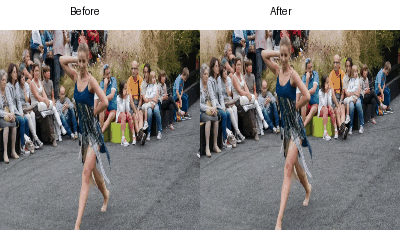

 Saved GIF: davis_comparison_1.gif



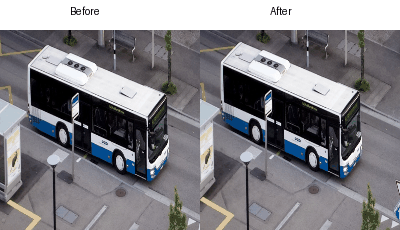

 Saved GIF: davis_comparison_2.gif



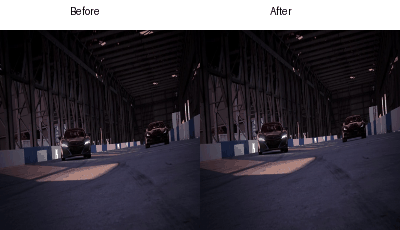

 Saved GIF: davis_comparison_3.gif



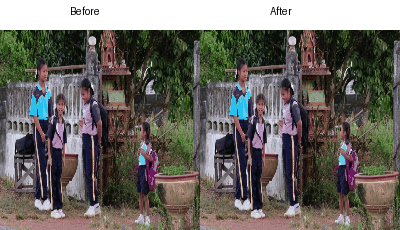

 Saved GIF: davis_comparison_4.gif



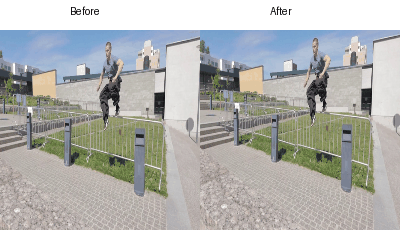

In [ ]:
import random

sample_videos = random.sample(list(video_frames.keys()), 5)

for idx, vid_name in enumerate(sample_videos):
    create_comparison_gif(
        vid_name,
        output_path=f"davis_comparison_{idx}.gif"
    )


In [ ]:


import torch
import torch.nn as nn

class TransformerMotionSmoother(nn.Module):
    def __init__(self, input_dim=2, model_dim=64, num_heads=4, num_layers=2, dropout=0.1):
        super().__init__()
        self.input_proj = nn.Linear(input_dim, model_dim)
        self.pos_encoder = PositionalEncoding(model_dim, dropout)

        encoder_layer = nn.TransformerEncoderLayer(
            d_model=model_dim, nhead=num_heads, dim_feedforward=128, dropout=dropout
        )
        self.transformer = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)

        self.output_proj = nn.Linear(model_dim, input_dim)

    def forward(self, x):
        x = self.input_proj(x)
        x = self.pos_encoder(x)
        x = self.transformer(x)
        return self.output_proj(x)


class PositionalEncoding(nn.Module):
    def __init__(self, d_model, dropout=0.1, max_len=500):
        super().__init__()
        self.dropout = nn.Dropout(p=dropout)

        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-torch.log(torch.tensor(10000.0)) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:, :x.size(1)]
        return self.dropout(x)


In [ ]:
import torch
import torch.nn as nn
import math


class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=500):
        super().__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1).float()
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        self.register_buffer('pe', pe)

    def forward(self, x):
        return x + self.pe[:, :x.size(1)]


In [ ]:
class MotionTransformer(nn.Module):
    def __init__(self, input_dim=2, model_dim=64, num_heads=4, num_layers=3, dropout=0.1):
        super().__init__()
        self.input_proj = nn.Linear(input_dim, model_dim)
        self.pos_encoder = PositionalEncoding(model_dim)

        encoder_layer = nn.TransformerEncoderLayer(d_model=model_dim, nhead=num_heads, dropout=dropout, batch_first=True)
        self.transformer = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)

        self.output_proj = nn.Linear(model_dim, input_dim)

    def forward(self, x):
        x = self.input_proj(x)
        x = self.pos_encoder(x)
        x = self.transformer(x)
        return self.output_proj(x)


In [ ]:
model_trans = MotionTransformer().to(device)

inputs = motion_padded.to(device)
targets = target_padded.to(device)
mask = mask.to(device)

criterion = nn.MSELoss(reduction='none')
optimizer = torch.optim.Adam(model_trans.parameters(), lr=0.001)

num_epochs = 150
loss_list = []

for epoch in range(1, num_epochs + 1):
    model_trans.train()
    optimizer.zero_grad()

    outputs = model_trans(inputs)
    loss_per_timestep = criterion(outputs, targets).sum(dim=2)
    masked_loss = (loss_per_timestep * mask).sum() / mask.sum()

    masked_loss.backward()
    optimizer.step()
    loss_list.append(masked_loss.item())

    if epoch % 10 == 0 or epoch == 1:
        print(f"Epoch {epoch}, Loss: {masked_loss.item():.6f}")


Epoch 1, Loss: 4.772027
Epoch 10, Loss: 2.190294
Epoch 20, Loss: 1.601526
Epoch 30, Loss: 1.486060
Epoch 40, Loss: 1.390935
Epoch 50, Loss: 1.334954
Epoch 60, Loss: 1.298270
Epoch 70, Loss: 1.258399
Epoch 80, Loss: 1.219903
Epoch 90, Loss: 1.187514
Epoch 100, Loss: 1.157055
Epoch 110, Loss: 1.127084
Epoch 120, Loss: 1.096273
Epoch 130, Loss: 1.071178
Epoch 140, Loss: 1.042139
Epoch 150, Loss: 1.018817


In [ ]:
torch.save(model_trans.state_dict(), "transformer_motion_smoother.pth")
print("Saved model as transformer_motion_smoother.pth")


Saved model as transformer_motion_smoother.pth


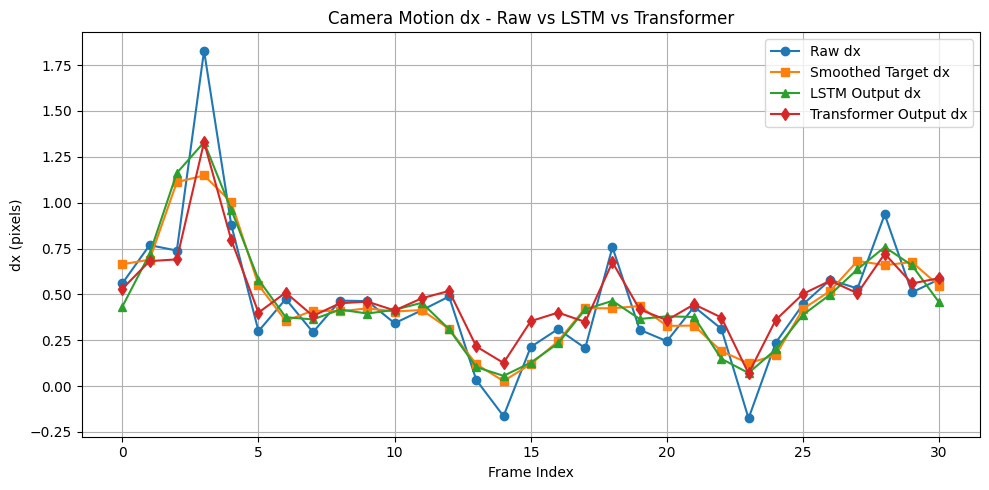

In [ ]:
import matplotlib.pyplot as plt

sample_idx = 0
raw_seq = motion_tensors[sample_idx].unsqueeze(0).to(device)
target_seq = target_tensors[sample_idx].cpu().numpy()

model_trans.eval()
with torch.no_grad():
    pred_trans = model_trans(raw_seq).squeeze(0).cpu().numpy()

model_lstm.eval()
with torch.no_grad():
    pred_lstm = model_lstm(raw_seq).squeeze(0).cpu().numpy()

raw_seq_np = raw_seq.squeeze(0).cpu().numpy()

plt.figure(figsize=(10, 5))
plt.plot(raw_seq_np[:, 0], 'o-', label='Raw dx')
plt.plot(target_seq[:, 0], 's-', label='Smoothed Target dx')
plt.plot(pred_lstm[:, 0], '^-', label='LSTM Output dx')
plt.plot(pred_trans[:, 0], 'd-', label='Transformer Output dx')
plt.title("Camera Motion dx - Raw vs LSTM vs Transformer")
plt.xlabel("Frame Index")
plt.ylabel("dx (pixels)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


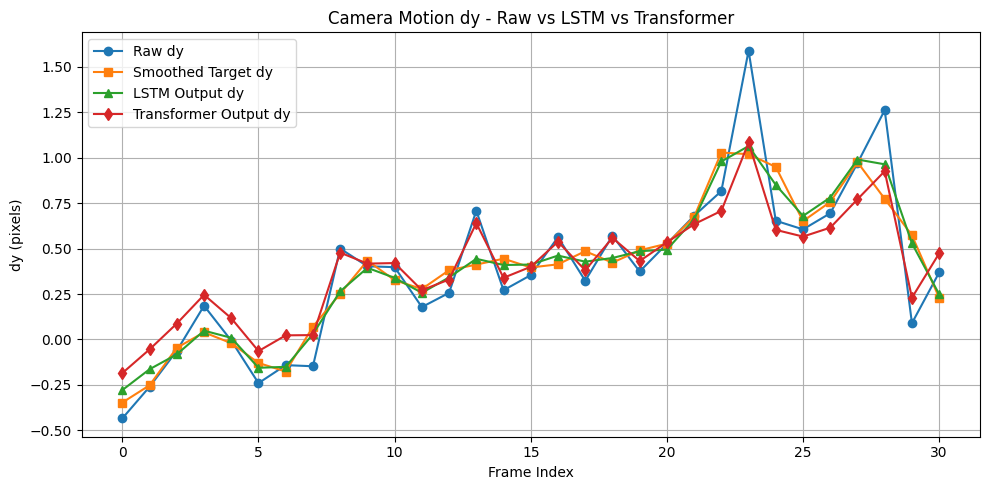

In [ ]:
import matplotlib.pyplot as plt

raw_dy = raw_seq.squeeze(0).cpu().numpy()[:, 1]
target_dy = target_seq[:, 1]
pred_lstm_dy = pred_lstm[:, 1]
pred_trans_dy = pred_trans[:, 1]

plt.figure(figsize=(10, 5))
plt.plot(raw_dy, 'o-', label='Raw dy')
plt.plot(target_dy, 's-', label='Smoothed Target dy')
plt.plot(pred_lstm_dy, '^-', label='LSTM Output dy')
plt.plot(pred_trans_dy, 'd-', label='Transformer Output dy')
plt.title("Camera Motion dy - Raw vs LSTM vs Transformer")
plt.xlabel("Frame Index")
plt.ylabel("dy (pixels)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
import torch
import torch.nn as nn

class MotionGRU(nn.Module):
    def __init__(self, input_dim=2, hidden_dim=32):
        super().__init__()
        self.gru = nn.GRU(input_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, input_dim)

    def forward(self, x):
        out, _ = self.gru(x)
        return self.fc(out)

model_gru = MotionGRU().to(device)

optimizer = torch.optim.Adam(model_gru.parameters(), lr=0.01)
criterion = nn.MSELoss(reduction='none')

losses_gru = []

for epoch in range(1, 201):
    model_gru.train()
    optimizer.zero_grad()
    out = model_gru(motion_padded)
    loss_ts = criterion(out, target_padded).sum(dim=2)
    masked_loss = (loss_ts * mask).sum() / mask.sum()
    masked_loss.backward()
    optimizer.step()

    losses_gru.append(masked_loss.item())

    if epoch % 25 == 0:
        print(f"Epoch {epoch}, GRU Loss: {masked_loss.item():.6f}")

torch.save(model_gru.state_dict(), "motion_gru_smoother.pth")


Epoch 25, GRU Loss: 1.022110
Epoch 50, GRU Loss: 0.741686
Epoch 75, GRU Loss: 0.601311
Epoch 100, GRU Loss: 0.524312
Epoch 125, GRU Loss: 0.479276
Epoch 150, GRU Loss: 0.449738
Epoch 175, GRU Loss: 0.428942
Epoch 200, GRU Loss: 0.421913


In [ ]:
model_gru.eval()
with torch.no_grad():
    pred_gru = model_gru(raw_seq).squeeze(0).cpu().numpy()


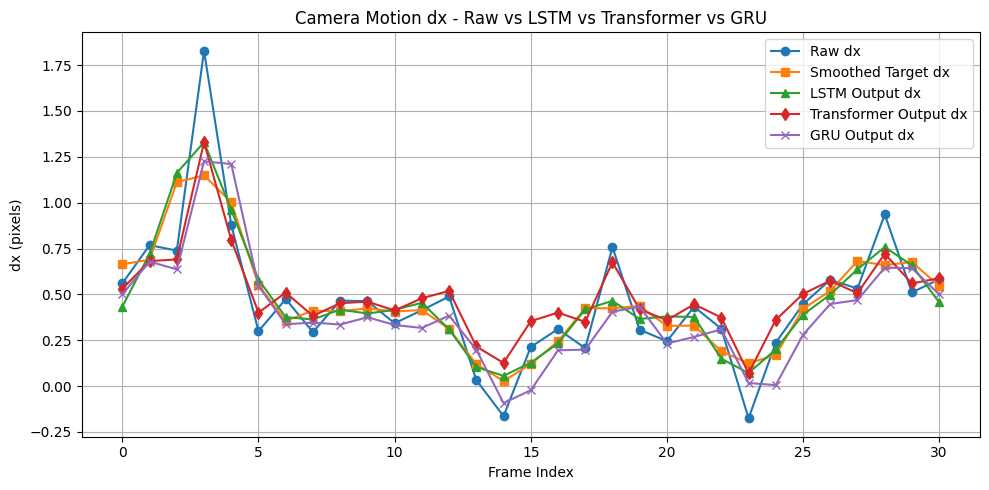

In [ ]:
import matplotlib.pyplot as plt

raw_dx = raw_seq.squeeze(0).cpu().numpy()[:, 0]
target_dx = target_seq.reshape(-1, 2)[:, 0]
pred_lstm_dx = pred_lstm[:, 0]
pred_trans_dx = pred_trans[:, 0]
pred_gru_dx = pred_gru[:, 0]

plt.figure(figsize=(10, 5))
plt.plot(raw_dx, 'o-', label='Raw dx')
plt.plot(target_dx, 's-', label='Smoothed Target dx')
plt.plot(pred_lstm_dx, '^-', label='LSTM Output dx')
plt.plot(pred_trans_dx, 'd-', label='Transformer Output dx')
plt.plot(pred_gru_dx, 'x-', label='GRU Output dx')
plt.title("Camera Motion dx - Raw vs LSTM vs Transformer vs GRU")
plt.xlabel("Frame Index")
plt.ylabel("dx (pixels)")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


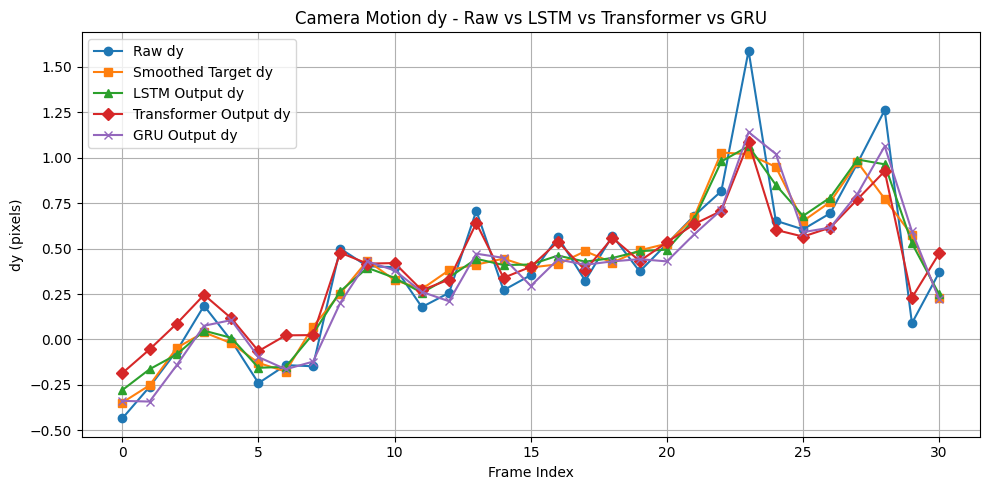

In [ ]:
raw_dy = raw_seq.squeeze(0).cpu().numpy()[:, 1]
target_dy = target_seq[:, 1]
pred_lstm_dy = pred_lstm[:, 1]
pred_trans_dy = pred_trans[:, 1]
pred_gru_dy = pred_gru[:, 1]

plt.figure(figsize=(10, 5))
plt.plot(raw_dy, 'o-', label="Raw dy")
plt.plot(target_dy, 's-', label="Smoothed Target dy")
plt.plot(pred_lstm_dy, '^-', label="LSTM Output dy")
plt.plot(pred_trans_dy, 'D-', label="Transformer Output dy")
plt.plot(pred_gru_dy, 'x-', label="GRU Output dy")
plt.title("Camera Motion dy - Raw vs LSTM vs Transformer vs GRU")
plt.xlabel("Frame Index")
plt.ylabel("dy (pixels)")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()
